# Bean Leaf Disease Classification

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import os
import gc
import matplotlib.pyplot as plt
import albumentations as A
from glob import glob
from PIL import Image
from tqdm import tqdm
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.optimizers import Adam, Nadam, RMSprop
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.models import load_model
from keras.applications import MobileNetV2, NASNetMobile, EfficientNetB6
from keras.applications.mobilenet import preprocess_input as mobile_net_preprocess
from keras.applications.nasnet import preprocess_input as nasnet_preprocess
from keras.models import load_model
from keras.utils import plot_model

## Loading Data

In [2]:
BATCH_SIZE = 32
RESIZE_SHAPE = (224, 224)
TRAIN_DIR = "Data/train"
VAL_DIR = "Data/validation"
TEST_DIR = "Data/test"


train_data = image_dataset_from_directory(
    TRAIN_DIR,
    image_size=RESIZE_SHAPE,  
    batch_size=BATCH_SIZE,         
    label_mode="categorical"  
)

validation_data = image_dataset_from_directory(
    VAL_DIR,
    image_size=RESIZE_SHAPE,
    batch_size=BATCH_SIZE,
    label_mode="categorical"
)

test_data = image_dataset_from_directory(
    TEST_DIR,
    image_size=RESIZE_SHAPE,
    batch_size=BATCH_SIZE,
    label_mode="categorical"
)

Found 1034 files belonging to 3 classes.
Found 133 files belonging to 3 classes.
Found 128 files belonging to 3 classes.


### Show Sample Images

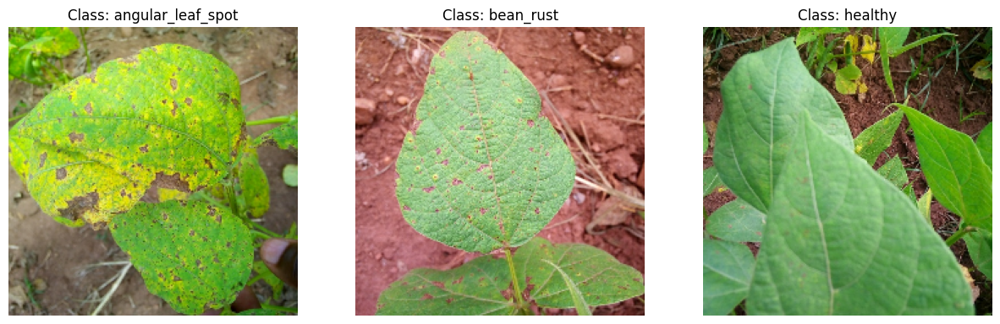

In [3]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np

def show_random_imgs(dataset):
    classes = dataset.class_names

    fig, axes = plt.subplots(1, len(classes), figsize=(15, 5))

    for ax, cls in zip(axes, classes):
        for images, labels in dataset.unbatch():
            if tf.argmax(labels).numpy() == classes.index(cls):
                image_array = images.numpy().astype('uint8')
                ax.imshow(image_array)
                ax.set_title(f"Class: {cls}")
                ax.axis('off')
                break  

    plt.show()

show_random_imgs(train_data)


## Augmentation

In [4]:
AUG_PROB = 0.05

augmentations_high_prob = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.Transpose(p=0.5),
    A.Rotate(limit=(10, 30), p=0.5),
    A.Perspective(scale=(0.05,0.1),p=0.5),
    
    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5), 
    A.GaussNoise(var_limit=(10.0, 50.0), p=0.5)],
    seed=42)


augmentations_low_prob = A.Compose([
    A.HorizontalFlip(p=AUG_PROB),
    A.VerticalFlip(p=AUG_PROB),
    A.Transpose(p=AUG_PROB),
    A.Rotate(limit=(10, 30), p=AUG_PROB),
    A.Perspective(scale=(AUG_PROB,0.1),p=AUG_PROB),
    
    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=AUG_PROB),
    A.GaussNoise(var_limit=(10.0, 50.0), p=AUG_PROB)],
    seed=42)

In [5]:
1 - 0.95**6

0.2649081093750002

### Show Augmented Images vs Original Images

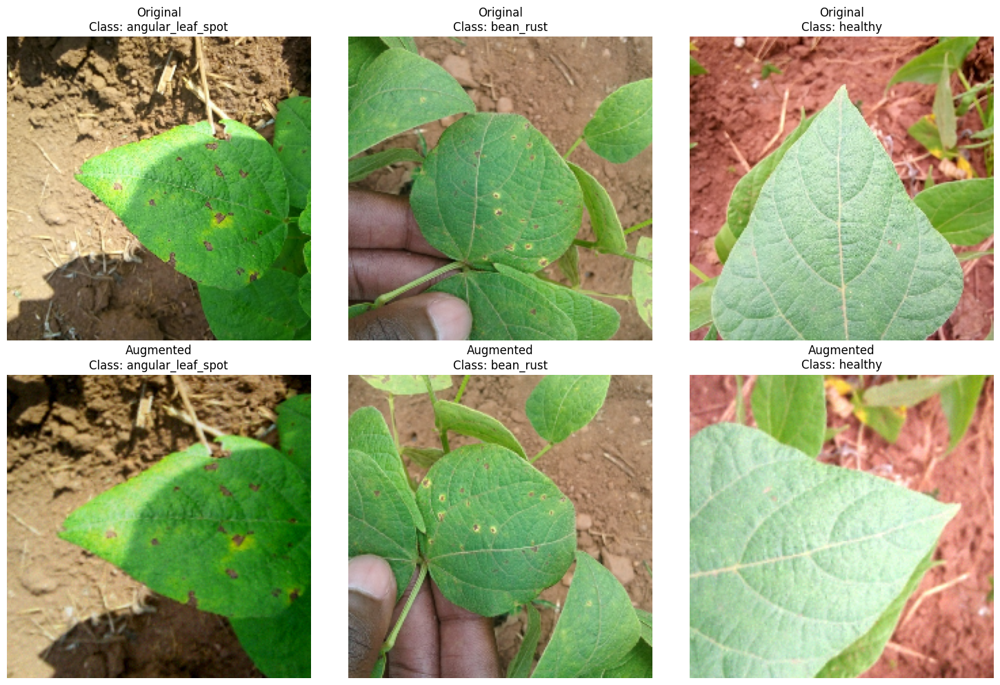

In [8]:
class_names = train_data.class_names

fig, axes = plt.subplots(2, len(class_names), figsize=(15, 10))  

train_data_unbatched = train_data.unbatch().as_numpy_iterator()
images, labels = zip(*list(train_data_unbatched))  

for i, class_name in enumerate(class_names):
    class_indices = [idx for idx, label in enumerate(labels) if np.argmax(label) == i]
    class_images = np.array(images)[class_indices]

    random_image = class_images[np.random.choice(len(class_images))].astype('uint8')

    axes[0, i].imshow(random_image)
    axes[0, i].set_title(f"Original\nClass: {class_name}")
    axes[0, i].axis("off")

    augmented_image = augmentations_high_prob(image=random_image)["image"]

    axes[1, i].imshow(augmented_image)
    axes[1, i].set_title(f"Augmented\nClass: {class_name}")
    axes[1, i].axis("off")

plt.tight_layout()
plt.show()

In [7]:
class AlbumentationsGenerator(tf.keras.utils.Sequence):
    def __init__(self, dataset, augmentations, preprocess_function=None, batch_size=32):
        self.dataset = dataset.unbatch().as_numpy_iterator()
        self.augmentations = augmentations
        self.batch_size = batch_size
        self.preprocess_function = preprocess_function
        self.images, self.labels = zip(*list(self.dataset))  

    def __len__(self):
        return len(self.images) // self.batch_size

    def __getitem__(self, idx):
        batch_images = np.array(self.images[idx * self.batch_size:(idx + 1) * self.batch_size]).astype('uint8')
        batch_labels = np.array(self.labels[idx * self.batch_size:(idx + 1) * self.batch_size])

        augmented_images = np.array([self.augmentations(image=img)['image'] for img in batch_images])
        if self.preprocess_function:
            augmented_images = self.preprocess_function(augmented_images)

        return augmented_images, batch_labels


## Pre-Trained Models

### MobileNetV2

In [14]:
mobile_net_v2 = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))    

mobile_net_v2.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                              

### NasNetMobile

In [15]:
nasnet = NASNetMobile(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

nasnet.summary()

Model: "NASNet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 stem_conv1 (Conv2D)            (None, 111, 111, 32  864         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 stem_bn1 (BatchNormalization)  (None, 111, 111, 32  128         ['stem_conv1[0][0]']             
                                )                                                            

### EfficientNetB6

In [16]:
efficient_net_b6 = EfficientNetB6(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

efficient_net_b6.summary()

Model: "efficientnetb6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['input_3[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 224, 224, 3)  7           ['rescaling[0][0]']              
                                                                                                  
 rescaling_1 (Rescaling)        (None, 224, 224, 3)  0           ['normalization[0][0

## Transfer Learning Implementation

In [17]:
def create_model(base_model):
    
    base_model.trainable = False

    model = Sequential()

    model.add(base_model)
    model.add(GlobalAveragePooling2D())
    model.add(Dropout(0.3))
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.3))
    
    model.add(Dense(3, activation='softmax'))
    
    return model

In [8]:
LEARNING_RATE = 0.001
BATCH_SIZE = 32
EPOCHS = 25
MIN_DELTA = 0.001
PATIENCE = 5

def plot_training_history(history):
    plt.figure(figsize=(20, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.legend()
    plt.title('Accuracy')

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.title('Loss')

    plt.show()
    

def train_model(model, optimizer, name, preprocess_function=None):    
    model.compile(optimizer=optimizer(learning_rate=LEARNING_RATE), 
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])

    checkpoint_filepath = f'checkpoints/best_model_{name}.h5'
    model_checkpoint = ModelCheckpoint(filepath=checkpoint_filepath, monitor='val_loss', save_best_only=True, mode='min', verbose=1)

    early_stopping = EarlyStopping(monitor='val_loss', patience=PATIENCE, min_delta=MIN_DELTA, restore_best_weights=True)  
    
    train_generator = AlbumentationsGenerator(train_data,
                                              augmentations_low_prob,
                                              preprocess_function=preprocess_function,
                                              batch_size=BATCH_SIZE)
    
    val_data = validation_data
    
    if preprocess_function:
        val_data = val_data.map(lambda x, y: (preprocess_function(x), y))
    
    steps_per_epoch = len(train_generator)

    history = model.fit(train_generator, 
                        epochs=EPOCHS,
                        steps_per_epoch=steps_per_epoch, 
                        validation_data=val_data, 
                        callbacks=[early_stopping, model_checkpoint])
    
    plot_training_history(history)
    
    return load_model(checkpoint_filepath)


def calc_accuracy_on_test_data(model, preprocess_function=None):
    test_data_in = test_data
    if preprocess_function:
        test_data_in = test_data_in.map(lambda x, y: (preprocess_function(x), y))
    loss, accuracy = model.evaluate(test_data_in)    
    print('Test accuracy: ', accuracy)
    return loss, accuracy
    

## Training

In [19]:
AUG_PROB = 0.05

1 - (1-AUG_PROB)**6

0.2649081093750002

### MobileNetV2

#### Adam

In [72]:
model_mobile_net_v2_adam = create_model(mobile_net_v2)

model_mobile_net_v2_adam.summary(show_trainable=True)

Model: "sequential_11"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   N          
 ional)                                                                     
                                                                            
 global_average_pooling2d_11  (None, 1280)             0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_43 (Dropout)        (None, 1280)              0         Y          
                                                                            
 dense_43 (Dense)            (None, 128)               163968    Y          
                                                                            
 dropout_44 (Dropout)        (None, 128)             

In [73]:
#plot_model(model_mobile_net_v2_adam, to_file='model.png', show_shapes=True, show_layer_names=True)

Epoch 1/25
31/32 [============================>.] - ETA: 0s - loss: 0.9329 - accuracy: 0.5625
Epoch 1: val_loss improved from inf to 0.54331, saving model to checkpoints\best_model_mobile_net_adam.h5
32/32 [==============================] - 5s 96ms/step - loss: 0.9236 - accuracy: 0.5693 - val_loss: 0.5433 - val_accuracy: 0.7820
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.5975 - accuracy: 0.7402
Epoch 2: val_loss improved from 0.54331 to 0.39172, saving model to checkpoints\best_model_mobile_net_adam.h5
32/32 [==============================] - 2s 67ms/step - loss: 0.5975 - accuracy: 0.7402 - val_loss: 0.3917 - val_accuracy: 0.8496
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.4953 - accuracy: 0.7998
Epoch 3: val_loss improved from 0.39172 to 0.32937, saving model to checkpoints\best_model_mobile_net_adam.h5
32/32 [==============================] - 2s 70ms/step - loss: 0.4953 - accuracy: 0.7998 - val_loss: 0.3294 - val_accuracy: 0.8647
Ep

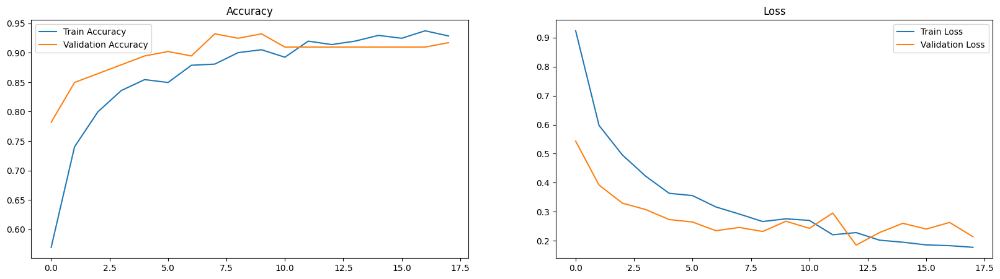

In [74]:
model_mobile_net_v2_adam = train_model(model_mobile_net_v2_adam, Adam, "mobile_net_adam", mobile_net_preprocess)

In [75]:
loss_mobile_net_adam, accuracy_mobile_net_adam = calc_accuracy_on_test_data(model_mobile_net_v2_adam, mobile_net_preprocess)

4/4 [==============================] - 1s 42ms/step - loss: 0.2569 - accuracy: 0.9062
Test accuracy:  0.90625


#### Nadam

In [93]:
model_mobile_net_v2_nadam = create_model(mobile_net_v2)

model_mobile_net_v2_nadam.summary(show_trainable=True)

Model: "sequential_18"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   N          
 ional)                                                                     
                                                                            
 global_average_pooling2d_18  (None, 1280)             0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_64 (Dropout)        (None, 1280)              0         Y          
                                                                            
 dense_64 (Dense)            (None, 128)               163968    Y          
                                                                            
 dropout_65 (Dropout)        (None, 128)             

Epoch 1/25
32/32 [==============================] - ETA: 0s - loss: 0.8924 - accuracy: 0.5840
Epoch 1: val_loss improved from inf to 0.50593, saving model to checkpoints\best_model_mobile_net_nadam.h5
32/32 [==============================] - 6s 99ms/step - loss: 0.8924 - accuracy: 0.5840 - val_loss: 0.5059 - val_accuracy: 0.8271
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.5931 - accuracy: 0.7324
Epoch 2: val_loss improved from 0.50593 to 0.37996, saving model to checkpoints\best_model_mobile_net_nadam.h5
32/32 [==============================] - 2s 72ms/step - loss: 0.5931 - accuracy: 0.7324 - val_loss: 0.3800 - val_accuracy: 0.8421
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.4542 - accuracy: 0.8105
Epoch 3: val_loss improved from 0.37996 to 0.31449, saving model to checkpoints\best_model_mobile_net_nadam.h5
32/32 [==============================] - 2s 74ms/step - loss: 0.4542 - accuracy: 0.8105 - val_loss: 0.3145 - val_accuracy: 0.8797

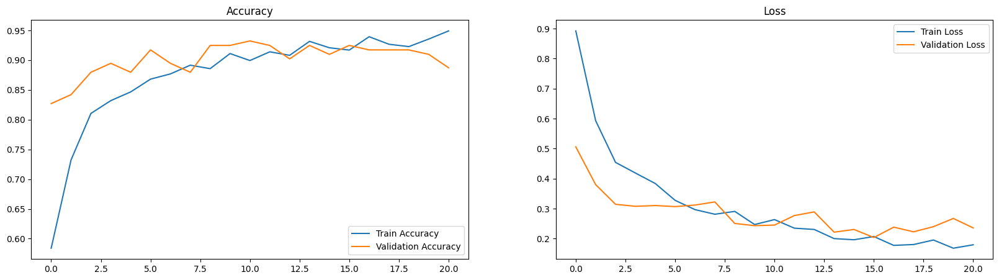

In [94]:
model_mobile_net_v2_nadam = train_model(model_mobile_net_v2_nadam, Nadam, "mobile_net_nadam", mobile_net_preprocess)

In [95]:
loss_mobile_net_nadam, accuracy_mobile_net_nadam = calc_accuracy_on_test_data(model_mobile_net_v2_nadam, mobile_net_preprocess)

4/4 [==============================] - 1s 83ms/step - loss: 0.2268 - accuracy: 0.9141
Test accuracy:  0.9140625


#### RMSprop

In [77]:
model_mobile_net_v2_rmsprop = create_model(mobile_net_v2)

model_mobile_net_v2_rmsprop.summary(show_trainable=True)

Model: "sequential_13"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   N          
 ional)                                                                     
                                                                            
 global_average_pooling2d_13  (None, 1280)             0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_49 (Dropout)        (None, 1280)              0         Y          
                                                                            
 dense_49 (Dense)            (None, 128)               163968    Y          
                                                                            
 dropout_50 (Dropout)        (None, 128)             

Epoch 1/25
31/32 [============================>.] - ETA: 0s - loss: 0.9880 - accuracy: 0.5776
Epoch 1: val_loss improved from inf to 0.50819, saving model to checkpoints\best_model_mobile_net_rmsprop.h5
32/32 [==============================] - 6s 98ms/step - loss: 0.9776 - accuracy: 0.5840 - val_loss: 0.5082 - val_accuracy: 0.7970
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.6335 - accuracy: 0.7334
Epoch 2: val_loss improved from 0.50819 to 0.40459, saving model to checkpoints\best_model_mobile_net_rmsprop.h5
32/32 [==============================] - 2s 67ms/step - loss: 0.6335 - accuracy: 0.7334 - val_loss: 0.4046 - val_accuracy: 0.8195
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.5255 - accuracy: 0.7871
Epoch 3: val_loss improved from 0.40459 to 0.33990, saving model to checkpoints\best_model_mobile_net_rmsprop.h5
32/32 [==============================] - 2s 64ms/step - loss: 0.5255 - accuracy: 0.7871 - val_loss: 0.3399 - val_accuracy: 

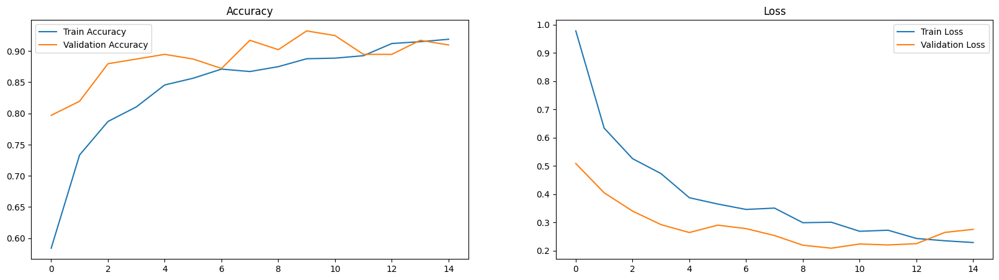

In [78]:
model_mobile_net_v2_rmsprop = train_model(model_mobile_net_v2_rmsprop, RMSprop, "mobile_net_rmsprop", mobile_net_preprocess)

In [89]:
loss_mobile_net_rmsprop, accuracy_mobile_net_rmsprop = calc_accuracy_on_test_data(model_mobile_net_v2_rmsprop, mobile_net_preprocess)

4/4 [==============================] - 1s 58ms/step - loss: 0.2239 - accuracy: 0.9141
Test accuracy:  0.9140625


### NasNetMobile

#### Adam

In [86]:
model_nasnet_adam = create_model(nasnet)

model_nasnet_adam.summary(show_trainable=True)

Model: "sequential_16"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 NASNet (Functional)         (None, 7, 7, 1056)        4269716   N          
                                                                            
 global_average_pooling2d_16  (None, 1056)             0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_58 (Dropout)        (None, 1056)              0         Y          
                                                                            
 dense_58 (Dense)            (None, 128)               135296    Y          
                                                                            
 dropout_59 (Dropout)        (None, 128)               0         Y          
                                                     

Epoch 1/25
32/32 [==============================] - ETA: 0s - loss: 0.9906 - accuracy: 0.5176
Epoch 1: val_loss improved from inf to 0.70366, saving model to checkpoints\best_model_nas_net_adam.h5
32/32 [==============================] - 21s 290ms/step - loss: 0.9906 - accuracy: 0.5176 - val_loss: 0.7037 - val_accuracy: 0.7143
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.7714 - accuracy: 0.6484
Epoch 2: val_loss improved from 0.70366 to 0.60706, saving model to checkpoints\best_model_nas_net_adam.h5
32/32 [==============================] - 4s 131ms/step - loss: 0.7714 - accuracy: 0.6484 - val_loss: 0.6071 - val_accuracy: 0.7594
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.6898 - accuracy: 0.7002
Epoch 3: val_loss improved from 0.60706 to 0.56618, saving model to checkpoints\best_model_nas_net_adam.h5
32/32 [==============================] - 4s 129ms/step - loss: 0.6898 - accuracy: 0.7002 - val_loss: 0.5662 - val_accuracy: 0.8045
Epoch 4

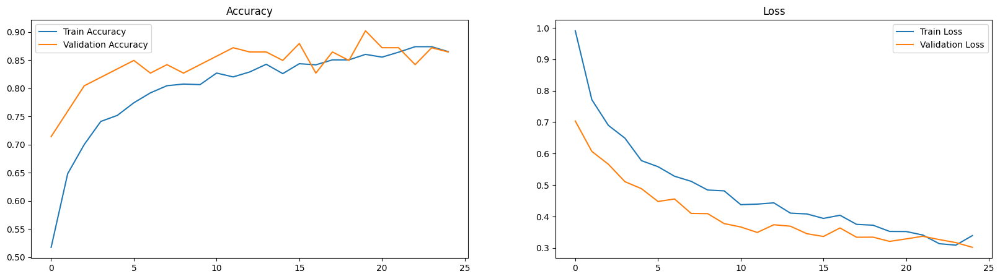

In [87]:
model_nasnet_adam = train_model(model_nasnet_adam, Adam, "nas_net_adam", nasnet_preprocess)

In [88]:
loss_nasnet_adam, accuracy_nasnet_adam = calc_accuracy_on_test_data(model_nasnet_adam, nasnet_preprocess)

4/4 [==============================] - 4s 72ms/step - loss: 0.3654 - accuracy: 0.8672
Test accuracy:  0.8671875


#### Nadam

In [80]:
model_nasnet_nadam = create_model(nasnet)

model_nasnet_nadam.summary(show_trainable=True)

Model: "sequential_14"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 NASNet (Functional)         (None, 7, 7, 1056)        4269716   N          
                                                                            
 global_average_pooling2d_14  (None, 1056)             0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_52 (Dropout)        (None, 1056)              0         Y          
                                                                            
 dense_52 (Dense)            (None, 128)               135296    Y          
                                                                            
 dropout_53 (Dropout)        (None, 128)               0         Y          
                                                     

Epoch 1/25
32/32 [==============================] - ETA: 0s - loss: 1.0384 - accuracy: 0.5117
Epoch 1: val_loss improved from inf to 0.64750, saving model to checkpoints\best_model_nas_net_nadam.h5
32/32 [==============================] - 20s 236ms/step - loss: 1.0384 - accuracy: 0.5117 - val_loss: 0.6475 - val_accuracy: 0.7594
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.7181 - accuracy: 0.6953
Epoch 2: val_loss improved from 0.64750 to 0.59517, saving model to checkpoints\best_model_nas_net_nadam.h5
32/32 [==============================] - 4s 120ms/step - loss: 0.7181 - accuracy: 0.6953 - val_loss: 0.5952 - val_accuracy: 0.7594
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.6789 - accuracy: 0.7178
Epoch 3: val_loss improved from 0.59517 to 0.53155, saving model to checkpoints\best_model_nas_net_nadam.h5
32/32 [==============================] - 4s 121ms/step - loss: 0.6789 - accuracy: 0.7178 - val_loss: 0.5315 - val_accuracy: 0.8045
Epoc

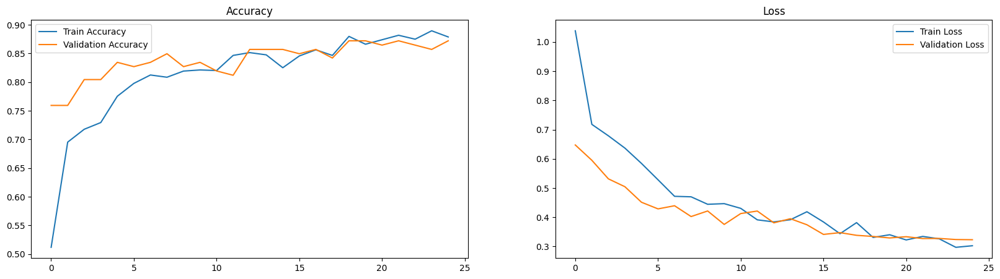

In [81]:
model_nasnet_nadam = train_model(model_nasnet_nadam, Nadam, "nas_net_nadam", nasnet_preprocess)

In [82]:
loss_nasnet_nadam, accuracy_nasnet_nadam = calc_accuracy_on_test_data(model_nasnet_nadam, nasnet_preprocess)

4/4 [==============================] - 5s 72ms/step - loss: 0.3729 - accuracy: 0.8906
Test accuracy:  0.890625


#### RMSprop

In [83]:
model_nasnet_rmsprop = create_model(nasnet)

model_nasnet_rmsprop.summary(show_trainable=True)

Model: "sequential_15"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 NASNet (Functional)         (None, 7, 7, 1056)        4269716   N          
                                                                            
 global_average_pooling2d_15  (None, 1056)             0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_55 (Dropout)        (None, 1056)              0         Y          
                                                                            
 dense_55 (Dense)            (None, 128)               135296    Y          
                                                                            
 dropout_56 (Dropout)        (None, 128)               0         Y          
                                                     

Epoch 1/25
32/32 [==============================] - ETA: 0s - loss: 0.9226 - accuracy: 0.5723
Epoch 1: val_loss improved from inf to 0.64751, saving model to checkpoints\best_model_nas_net_rmsprop.h5
32/32 [==============================] - 21s 264ms/step - loss: 0.9226 - accuracy: 0.5723 - val_loss: 0.6475 - val_accuracy: 0.7068
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.7376 - accuracy: 0.6748
Epoch 2: val_loss improved from 0.64751 to 0.57664, saving model to checkpoints\best_model_nas_net_rmsprop.h5
32/32 [==============================] - 4s 126ms/step - loss: 0.7376 - accuracy: 0.6748 - val_loss: 0.5766 - val_accuracy: 0.8045
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.6817 - accuracy: 0.7158
Epoch 3: val_loss improved from 0.57664 to 0.51820, saving model to checkpoints\best_model_nas_net_rmsprop.h5
32/32 [==============================] - 4s 121ms/step - loss: 0.6817 - accuracy: 0.7158 - val_loss: 0.5182 - val_accuracy: 0.804

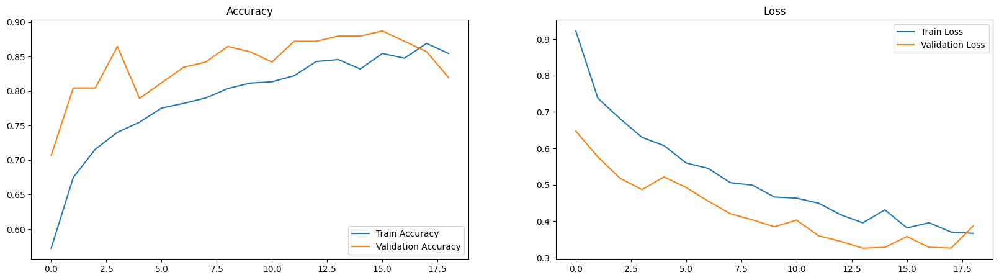

In [84]:
model_nasnet_rmsprop = train_model(model_nasnet_rmsprop, RMSprop, "nas_net_rmsprop", nasnet_preprocess)

In [85]:
loss_nasnet_rmsprop, accuracy_nasnet_rmsprop = calc_accuracy_on_test_data(model_nasnet_rmsprop, nasnet_preprocess)

4/4 [==============================] - 4s 69ms/step - loss: 0.3924 - accuracy: 0.8438
Test accuracy:  0.84375


### EfficientNetB6

#### Adam

In [20]:
model_efficient_net_adam = create_model(efficient_net_b6)

model_efficient_net_adam.summary(show_trainable=True)

Model: "sequential"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 efficientnetb6 (Functional)  (None, 7, 7, 2304)       40960143  N          
                                                                            
 global_average_pooling2d (G  (None, 2304)             0         Y          
 lobalAveragePooling2D)                                                     
                                                                            
 dropout (Dropout)           (None, 2304)              0         Y          
                                                                            
 dense (Dense)               (None, 128)               295040    Y          
                                                                            
 dropout_1 (Dropout)         (None, 128)               0         Y          
                                                        

Epoch 1/25
32/32 [==============================] - ETA: 0s - loss: 0.8478 - accuracy: 0.6025
Epoch 1: val_loss improved from inf to 0.52183, saving model to checkpoints\best_model_eff_net_adam.h5
32/32 [==============================] - 26s 407ms/step - loss: 0.8478 - accuracy: 0.6025 - val_loss: 0.5218 - val_accuracy: 0.8271
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.5665 - accuracy: 0.7695
Epoch 2: val_loss improved from 0.52183 to 0.39680, saving model to checkpoints\best_model_eff_net_adam.h5
32/32 [==============================] - 9s 289ms/step - loss: 0.5665 - accuracy: 0.7695 - val_loss: 0.3968 - val_accuracy: 0.8496
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.4607 - accuracy: 0.8145
Epoch 3: val_loss improved from 0.39680 to 0.33581, saving model to checkpoints\best_model_eff_net_adam.h5
32/32 [==============================] - 9s 290ms/step - loss: 0.4607 - accuracy: 0.8145 - val_loss: 0.3358 - val_accuracy: 0.8797
Epoch 4

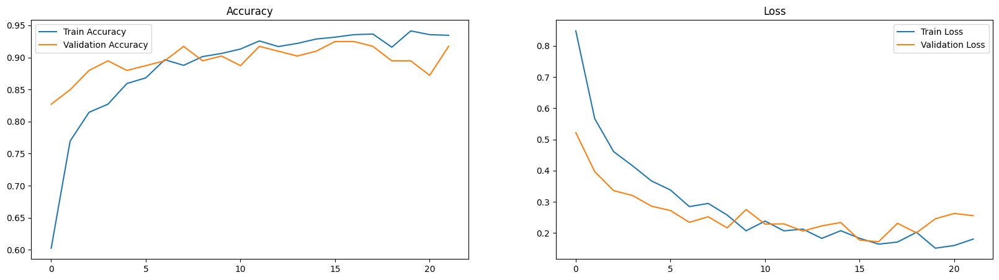

In [21]:
model_efficient_net_adam = train_model(model_efficient_net_adam, Adam, "eff_net_adam")

In [22]:
loss_efficient_net_adam, accuracy_efficient_net_adam = calc_accuracy_on_test_data(model_efficient_net_adam)

4/4 [==============================] - 5s 217ms/step - loss: 0.2875 - accuracy: 0.9062
Test accuracy:  0.90625


#### Nadam

In [29]:
model_efficient_net_nadam = create_model(efficient_net_b6)

model_efficient_net_nadam.summary(show_trainable=True)

Model: "sequential_3"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 efficientnetb6 (Functional)  (None, 7, 7, 2304)       40960143  N          
                                                                            
 global_average_pooling2d_3   (None, 2304)             0         Y          
 (GlobalAveragePooling2D)                                                   
                                                                            
 dropout_9 (Dropout)         (None, 2304)              0         Y          
                                                                            
 dense_9 (Dense)             (None, 128)               295040    Y          
                                                                            
 dropout_10 (Dropout)        (None, 128)               0         Y          
                                                      

Epoch 1/25
32/32 [==============================] - ETA: 0s - loss: 0.8862 - accuracy: 0.5889
Epoch 1: val_loss improved from inf to 0.63906, saving model to checkpoints\best_model_eff_net_nadam.h5
32/32 [==============================] - 28s 421ms/step - loss: 0.8862 - accuracy: 0.5889 - val_loss: 0.6391 - val_accuracy: 0.6917
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.5684 - accuracy: 0.7744
Epoch 2: val_loss improved from 0.63906 to 0.41934, saving model to checkpoints\best_model_eff_net_nadam.h5
32/32 [==============================] - 10s 300ms/step - loss: 0.5684 - accuracy: 0.7744 - val_loss: 0.4193 - val_accuracy: 0.8421
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.4776 - accuracy: 0.8066
Epoch 3: val_loss improved from 0.41934 to 0.36153, saving model to checkpoints\best_model_eff_net_nadam.h5
32/32 [==============================] - 10s 300ms/step - loss: 0.4776 - accuracy: 0.8066 - val_loss: 0.3615 - val_accuracy: 0.8571
Ep

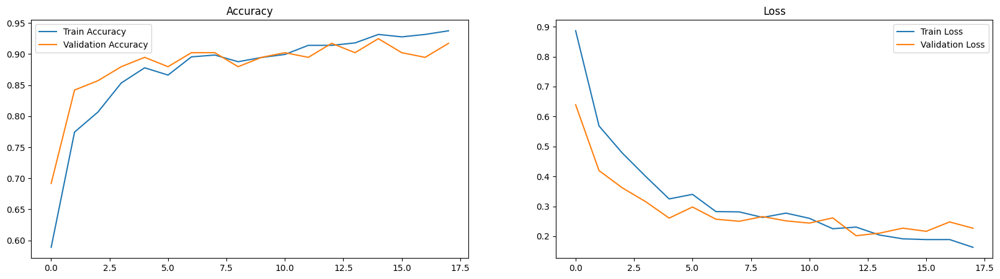

In [30]:
model_efficient_net_nadam = train_model(model_efficient_net_nadam, Nadam, "eff_net_nadam")

In [31]:
loss_efficient_net_nadam, accuracy_efficient_net_nadam = calc_accuracy_on_test_data(model_efficient_net_nadam)

4/4 [==============================] - 5s 219ms/step - loss: 0.2711 - accuracy: 0.9062
Test accuracy:  0.90625


#### RMSprop

In [38]:
model_efficient_net_rmsprop = create_model(efficient_net_b6)

model_efficient_net_rmsprop.summary(show_trainable=True)

Model: "sequential_6"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 efficientnetb6 (Functional)  (None, 7, 7, 2304)       40960143  N          
                                                                            
 global_average_pooling2d_6   (None, 2304)             0         Y          
 (GlobalAveragePooling2D)                                                   
                                                                            
 dropout_18 (Dropout)        (None, 2304)              0         Y          
                                                                            
 dense_18 (Dense)            (None, 128)               295040    Y          
                                                                            
 dropout_19 (Dropout)        (None, 128)               0         Y          
                                                      

Epoch 1/25
32/32 [==============================] - ETA: 0s - loss: 0.8630 - accuracy: 0.5830
Epoch 1: val_loss improved from inf to 0.53515, saving model to checkpoints\best_model_eff_net_rmsprop.h5
32/32 [==============================] - 28s 419ms/step - loss: 0.8630 - accuracy: 0.5830 - val_loss: 0.5352 - val_accuracy: 0.7744
Epoch 2/25
32/32 [==============================] - ETA: 0s - loss: 0.5729 - accuracy: 0.7715
Epoch 2: val_loss improved from 0.53515 to 0.42983, saving model to checkpoints\best_model_eff_net_rmsprop.h5
32/32 [==============================] - 10s 300ms/step - loss: 0.5729 - accuracy: 0.7715 - val_loss: 0.4298 - val_accuracy: 0.8271
Epoch 3/25
32/32 [==============================] - ETA: 0s - loss: 0.4562 - accuracy: 0.8164
Epoch 3: val_loss improved from 0.42983 to 0.36107, saving model to checkpoints\best_model_eff_net_rmsprop.h5
32/32 [==============================] - 10s 302ms/step - loss: 0.4562 - accuracy: 0.8164 - val_loss: 0.3611 - val_accuracy: 0.8

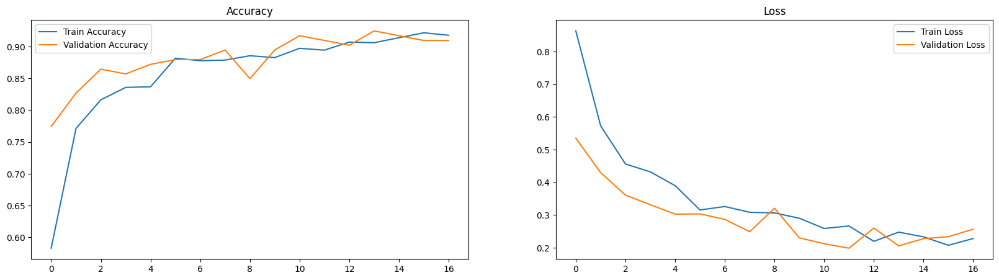

In [39]:
model_efficient_net_rmsprop = train_model(model_efficient_net_rmsprop, RMSprop,  "eff_net_rmsprop")

In [40]:
loss_efficient_net_rmsprop, accuracy_efficient_net_rmsprop = calc_accuracy_on_test_data(model_efficient_net_rmsprop)

4/4 [==============================] - 5s 221ms/step - loss: 0.3174 - accuracy: 0.8672
Test accuracy:  0.8671875


## Results

### Load and rerun best models

In [ ]:

def calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    model_path, 
    model_name,
    optimizer,
    preprocess_function=None, 
    results_csv_path="results.csv"
):
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"Model file not found at {model_path}")
    model = load_model(model_path)

    if preprocess_function:
        test_data = test_data.map(lambda x, y: (preprocess_function(x), y))
        validation_data = validation_data.map(lambda x, y: (preprocess_function(x), y))
    
    train_generator = AlbumentationsGenerator(train_data,
                                              augmentations_low_prob,
                                              preprocess_function=preprocess_function,
                                              batch_size=BATCH_SIZE)

    test_loss, test_accuracy = model.evaluate(test_data, verbose=0)
    val_loss, val_accuracy = model.evaluate(validation_data, verbose=0)
    train_loss, train_accuracy = model.evaluate(train_generator, verbose=0)

    results = {
        "Model Name": model_name,
        "Optimizer": optimizer,
        "Test Loss": test_loss,
        "Test Accuracy": test_accuracy,
        "Validation Loss": val_loss,
        "Validation Accuracy": val_accuracy,
        "Train Loss": train_loss,
        "Train Accuracy": train_accuracy,
    }

    if os.path.exists(results_csv_path):
        results_df = pd.read_csv(results_csv_path)
    else:
        results_df = pd.DataFrame(columns=results.keys())

    new_row = pd.DataFrame([results])  
    results_df = pd.concat([results_df, new_row], ignore_index=True)

    results_df.to_csv(results_csv_path, index=False)


    print(f"Results logged for model: {model_name}")
    print(results)

    return results


In [21]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_eff_net_adam.h5", 
    model_name="EfficientNetB6",
    optimizer="Adam"
)

Results logged for model: EfficientNetB6
{'Model Name': 'EfficientNetB6', 'Optimizer': 'Adam', 'Test Loss': 0.2874628007411957, 'Test Accuracy': 0.90625, 'Validation Loss': 0.1720050424337387, 'Validation Accuracy': 0.9248120188713074, 'Train Loss': 0.06895618140697479, 'Train Accuracy': 0.9736328125}


C:\Users\ALI\AppData\Local\Temp\ipykernel_20516\1198197896.py:51: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  results_df = pd.concat([results_df, new_row], ignore_index=True)


{'Model Name': 'EfficientNetB6',
 'Optimizer': 'Adam',
 'Test Loss': 0.2874628007411957,
 'Test Accuracy': 0.90625,
 'Validation Loss': 0.1720050424337387,
 'Validation Accuracy': 0.9248120188713074,
 'Train Loss': 0.06895618140697479,
 'Train Accuracy': 0.9736328125}

In [22]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_eff_net_nadam.h5", 
    model_name="EfficientNetB6",
    optimizer="Nadam"
)

Results logged for model: EfficientNetB6
{'Model Name': 'EfficientNetB6', 'Optimizer': 'Nadam', 'Test Loss': 0.271099328994751, 'Test Accuracy': 0.90625, 'Validation Loss': 0.2018675059080124, 'Validation Accuracy': 0.9172932505607605, 'Train Loss': 0.10832320153713226, 'Train Accuracy': 0.958984375}


{'Model Name': 'EfficientNetB6',
 'Optimizer': 'Nadam',
 'Test Loss': 0.271099328994751,
 'Test Accuracy': 0.90625,
 'Validation Loss': 0.2018675059080124,
 'Validation Accuracy': 0.9172932505607605,
 'Train Loss': 0.10832320153713226,
 'Train Accuracy': 0.958984375}

In [23]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_eff_net_rmsprop.h5", 
    model_name="EfficientNetB6",
    optimizer="RMSprop"
)

Results logged for model: EfficientNetB6
{'Model Name': 'EfficientNetB6', 'Optimizer': 'RMSprop', 'Test Loss': 0.3173553943634033, 'Test Accuracy': 0.8671875, 'Validation Loss': 0.19878920912742615, 'Validation Accuracy': 0.9097744226455688, 'Train Loss': 0.14836850762367249, 'Train Accuracy': 0.9482421875}


{'Model Name': 'EfficientNetB6',
 'Optimizer': 'RMSprop',
 'Test Loss': 0.3173553943634033,
 'Test Accuracy': 0.8671875,
 'Validation Loss': 0.19878920912742615,
 'Validation Accuracy': 0.9097744226455688,
 'Train Loss': 0.14836850762367249,
 'Train Accuracy': 0.9482421875}

In [25]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_mobile_net_adam.h5", 
    model_name="MobileNetV2",
    optimizer="Adam",
    preprocess_function=mobile_net_preprocess
)

Results logged for model: MobileNetV2
{'Model Name': 'MobileNetV2', 'Optimizer': 'Adam', 'Test Loss': 0.2569137215614319, 'Test Accuracy': 0.90625, 'Validation Loss': 0.18457181751728058, 'Validation Accuracy': 0.9097744226455688, 'Train Loss': 0.11356227099895477, 'Train Accuracy': 0.9560546875}


{'Model Name': 'MobileNetV2',
 'Optimizer': 'Adam',
 'Test Loss': 0.2569137215614319,
 'Test Accuracy': 0.90625,
 'Validation Loss': 0.18457181751728058,
 'Validation Accuracy': 0.9097744226455688,
 'Train Loss': 0.11356227099895477,
 'Train Accuracy': 0.9560546875}

In [26]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_mobile_net_nadam.h5", 
    model_name="MobileNetV2",
    optimizer="Nadam",
    preprocess_function=mobile_net_preprocess
)

Results logged for model: MobileNetV2
{'Model Name': 'MobileNetV2', 'Optimizer': 'Nadam', 'Test Loss': 0.22683854401111603, 'Test Accuracy': 0.9140625, 'Validation Loss': 0.20369866490364075, 'Validation Accuracy': 0.9248120188713074, 'Train Loss': 0.08468379825353622, 'Train Accuracy': 0.9736328125}


{'Model Name': 'MobileNetV2',
 'Optimizer': 'Nadam',
 'Test Loss': 0.22683854401111603,
 'Test Accuracy': 0.9140625,
 'Validation Loss': 0.20369866490364075,
 'Validation Accuracy': 0.9248120188713074,
 'Train Loss': 0.08468379825353622,
 'Train Accuracy': 0.9736328125}

In [27]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_mobile_net_rmsprop.h5", 
    model_name="MobileNetV2",
    optimizer="RMSprop",
    preprocess_function=mobile_net_preprocess
)

Results logged for model: MobileNetV2
{'Model Name': 'MobileNetV2', 'Optimizer': 'RMSprop', 'Test Loss': 0.22393283247947693, 'Test Accuracy': 0.9140625, 'Validation Loss': 0.2085089385509491, 'Validation Accuracy': 0.932330846786499, 'Train Loss': 0.12985078990459442, 'Train Accuracy': 0.9560546875}


{'Model Name': 'MobileNetV2',
 'Optimizer': 'RMSprop',
 'Test Loss': 0.22393283247947693,
 'Test Accuracy': 0.9140625,
 'Validation Loss': 0.2085089385509491,
 'Validation Accuracy': 0.932330846786499,
 'Train Loss': 0.12985078990459442,
 'Train Accuracy': 0.9560546875}

In [29]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_nas_net_adam.h5", 
    model_name="NasNet",
    optimizer="Adam",
    preprocess_function=nasnet_preprocess
)

Results logged for model: NasNet
{'Model Name': 'NasNet', 'Optimizer': 'Adam', 'Test Loss': 0.3653872311115265, 'Test Accuracy': 0.8671875, 'Validation Loss': 0.30193355679512024, 'Validation Accuracy': 0.8646616339683533, 'Train Loss': 0.18728812038898468, 'Train Accuracy': 0.9306640625}


{'Model Name': 'NasNet',
 'Optimizer': 'Adam',
 'Test Loss': 0.3653872311115265,
 'Test Accuracy': 0.8671875,
 'Validation Loss': 0.30193355679512024,
 'Validation Accuracy': 0.8646616339683533,
 'Train Loss': 0.18728812038898468,
 'Train Accuracy': 0.9306640625}

In [11]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_nas_net_nadam.h5", 
    model_name="NasNet",
    optimizer="Nadam",
    preprocess_function=nasnet_preprocess
)

Results logged for model: NasNet
{'Model Name': 'NasNet', 'Optimizer': 'Nadam', 'Test Loss': 0.37287014722824097, 'Test Accuracy': 0.890625, 'Validation Loss': 0.3231786787509918, 'Validation Accuracy': 0.8721804618835449, 'Train Loss': 0.20261868834495544, 'Train Accuracy': 0.923828125}


{'Model Name': 'NasNet',
 'Optimizer': 'Nadam',
 'Test Loss': 0.37287014722824097,
 'Test Accuracy': 0.890625,
 'Validation Loss': 0.3231786787509918,
 'Validation Accuracy': 0.8721804618835449,
 'Train Loss': 0.20261868834495544,
 'Train Accuracy': 0.923828125}

In [12]:
calc_and_log_accuracy(
    test_data,
    validation_data,
    train_data,
    "checkpoints/best_model_nas_net_rmsprop.h5", 
    model_name="NasNet",
    optimizer="RMSprop",
    preprocess_function=nasnet_preprocess
)

Results logged for model: NasNet
{'Model Name': 'NasNet', 'Optimizer': 'RMSprop', 'Test Loss': 0.39240431785583496, 'Test Accuracy': 0.84375, 'Validation Loss': 0.3259105086326599, 'Validation Accuracy': 0.8796992301940918, 'Train Loss': 0.2561870813369751, 'Train Accuracy': 0.900390625}


{'Model Name': 'NasNet',
 'Optimizer': 'RMSprop',
 'Test Loss': 0.39240431785583496,
 'Test Accuracy': 0.84375,
 'Validation Loss': 0.3259105086326599,
 'Validation Accuracy': 0.8796992301940918,
 'Train Loss': 0.2561870813369751,
 'Train Accuracy': 0.900390625}

### Tables

In [50]:
results = pd.read_csv("results.csv")

results

,Model Name,Optimizer,Test Loss,Test Accuracy,Validation Loss,Validation Accuracy,Train Loss,Train Accuracy
0,EfficientNetB6,Adam,0.287463,0.906250,0.172005,0.924812,0.068956,0.973633
1,EfficientNetB6,Nadam,0.271099,0.906250,0.201868,0.917293,0.108323,0.958984
2,EfficientNetB6,RMSprop,0.317355,0.867188,0.198789,0.909774,0.148369,0.948242
3,MobileNetV2,Adam,0.256914,0.906250,0.184572,0.909774,0.113562,0.956055
4,MobileNetV2,Nadam,0.226839,0.914062,0.203699,0.924812,0.084684,0.973633
5,MobileNetV2,RMSprop,0.223933,0.914062,0.208509,0.932331,0.129851,0.956055
6,NasNet,Adam,0.365387,0.867188,0.301934,0.864662,0.187288,0.930664
7,NasNet,Nadam,0.372870,0.890625,0.323179,0.872180,0.202619,0.923828
8,NasNet,RMSprop,0.392404,0.843750,0.325911,0.879699,0.256187,0.900391


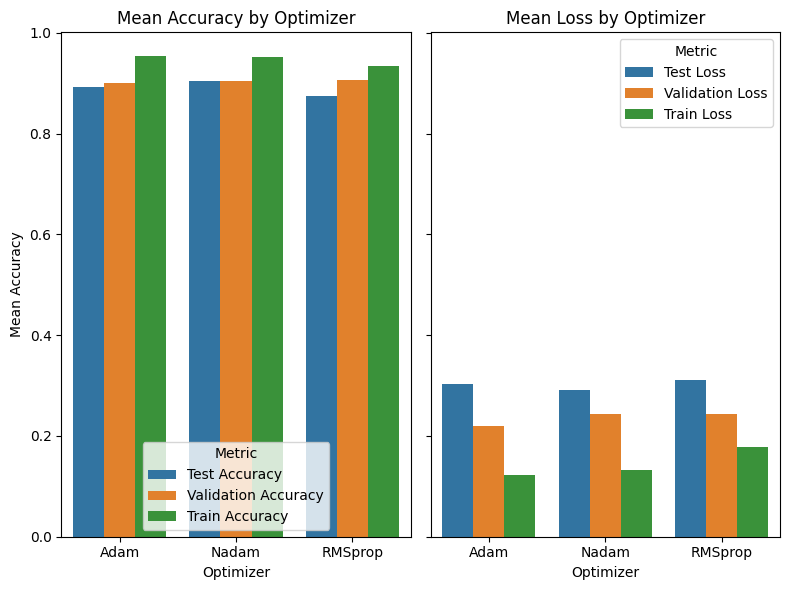

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt

metrics = results.groupby("Optimizer")[["Test Accuracy", "Validation Accuracy", "Train Accuracy", "Test Loss", "Validation Loss", "Train Loss"]].mean()
accuracy_metrics = metrics[["Test Accuracy", "Validation Accuracy", "Train Accuracy"]].reset_index().melt(id_vars=["Optimizer"], value_vars=["Test Accuracy", "Validation Accuracy", "Train Accuracy"], var_name="Metric", value_name="Accuracy")
loss_metrics = metrics[["Test Loss", "Validation Loss", "Train Loss"]].reset_index().melt(id_vars=["Optimizer"], value_vars=["Test Loss", "Validation Loss", "Train Loss"], var_name="Metric", value_name="Loss")

fig, axes = plt.subplots(1, 2, figsize=(8, 6), sharey=True)

sns.barplot(x="Optimizer", y="Accuracy", hue="Metric", data=accuracy_metrics, ax=axes[0])
axes[0].set_title("Mean Accuracy by Optimizer")
axes[0].set_ylabel("Mean Accuracy")
axes[0].set_xlabel("Optimizer")

sns.barplot(x="Optimizer", y="Loss", hue="Metric", data=loss_metrics, ax=axes[1])
axes[1].set_title("Mean Loss by Optimizer")
axes[1].set_ylabel("Mean Loss")
axes[1].set_xlabel("Optimizer")

plt.tight_layout()
plt.show()


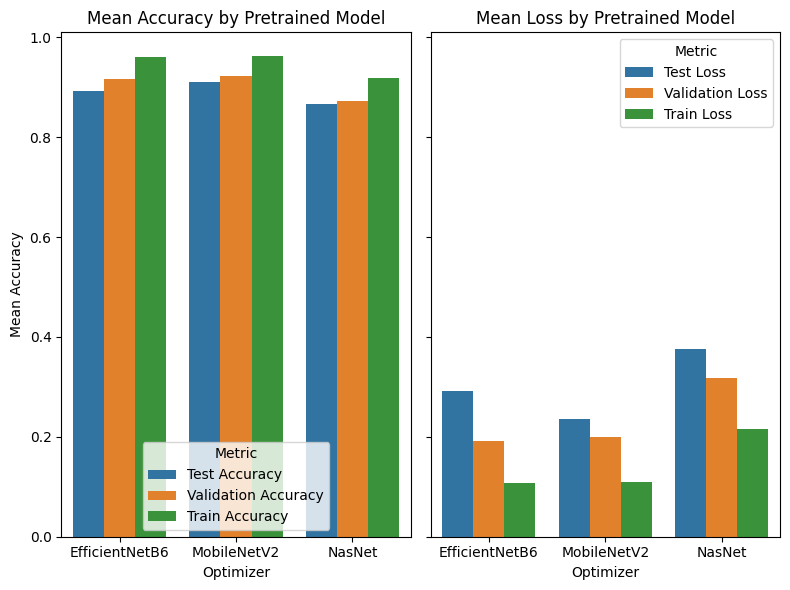

In [55]:
metrics = results.groupby("Model Name")[["Test Accuracy", "Validation Accuracy", "Train Accuracy", "Test Loss", "Validation Loss", "Train Loss"]].mean()
accuracy_metrics = metrics[["Test Accuracy", "Validation Accuracy", "Train Accuracy"]].reset_index().melt(id_vars=["Model Name"], value_vars=["Test Accuracy", "Validation Accuracy", "Train Accuracy"], var_name="Metric", value_name="Accuracy")
loss_metrics = metrics[["Test Loss", "Validation Loss", "Train Loss"]].reset_index().melt(id_vars=["Model Name"], value_vars=["Test Loss", "Validation Loss", "Train Loss"], var_name="Metric", value_name="Loss")

fig, axes = plt.subplots(1, 2, figsize=(8, 6), sharey=True)

sns.barplot(x="Model Name", y="Accuracy", hue="Metric", data=accuracy_metrics, ax=axes[0])
axes[0].set_title("Mean Accuracy by Pretrained Model")
axes[0].set_ylabel("Mean Accuracy")
axes[0].set_xlabel("Optimizer")

sns.barplot(x="Model Name", y="Loss", hue="Metric", data=loss_metrics, ax=axes[1])
axes[1].set_title("Mean Loss by Pretrained Model")
axes[1].set_ylabel("Mean Loss")
axes[1].set_xlabel("Optimizer")

plt.tight_layout()
plt.show()


In [6]:

def show_conf_matrix(test_data, model_path, model_name, preprocess_function=None):
    
    model = load_model(model_path)
    
    class_names = test_data.class_names

    if preprocess_function:
        test_data = test_data.map(lambda x, y: (preprocess_function(x), y))

    y_true = []
    y_pred = []
    
    for x, y in test_data:
        y_true.extend(np.argmax(y.numpy(), axis=1))
        y_pred.extend(model.predict(x, verbose=0))

    y_pred_classes = np.argmax(y_pred, axis=1)
    if len(np.unique(y_true)) == 2:
        y_pred_classes = (np.array(y_pred) > 0.5).astype("int32").flatten()

    cm = confusion_matrix(y_true, y_pred_classes)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot(cmap=plt.cm.Blues)
    plt.title(f"Confusion Matrix for {model_name}")
    plt.show()



### Confusion Matrix and Wrong Predictions

In [7]:
def show_wrong_predictions(test_data, model_path, model_name, preprocess_function=None):
    
    model = load_model(model_path)
    
    class_labels = test_data.class_names
    
    wrong_images = []
    wrong_true_labels = []
    wrong_pred_labels = []

    for x_batch, y_batch in test_data:
        y_true = np.argmax(y_batch.numpy(), axis=1) if len(y_batch.numpy().shape) > 1 else y_batch.numpy()
        if preprocess_function:
            y_pred = model.predict(preprocess_function(x_batch), verbose=0)
        else:
            y_pred = model.predict(x_batch, verbose=0)
        y_pred_classes = np.argmax(y_pred, axis=1)
        
        for img, true_label, pred_label in zip(x_batch.numpy(), y_true, y_pred_classes):
            if true_label != pred_label:
                wrong_images.append(img)
                wrong_true_labels.append(true_label)
                wrong_pred_labels.append(pred_label)

            if len(wrong_images) >= 5:
                break
        if len(wrong_images) >= 5:
            break

    if class_labels is None:
        class_labels = [f"Class {i}" for i in range(len(set(wrong_true_labels)))]  

    fig, axes = plt.subplots(1, 5, figsize=(20, 10))
    for i, ax in enumerate(axes):
        if i < len(wrong_images):
            ax.imshow(wrong_images[i].astype('uint8'))
            ax.axis('off')
            true_label = class_labels[wrong_true_labels[i]]
            pred_label = class_labels[wrong_pred_labels[i]]
            ax.set_title(f"True: {true_label}\n{model_name}'s Pred: {pred_label}", color="red", fontsize=12)
    plt.subplots_adjust(wspace=0.4)
    plt.tight_layout()
    plt.show()


In [8]:
def visualize_predictions(test_data, model_path, model_name, preprocess_function=None):
    show_conf_matrix(test_data, model_path, model_name, preprocess_function)
    show_wrong_predictions(test_data, model_path, model_name, preprocess_function)

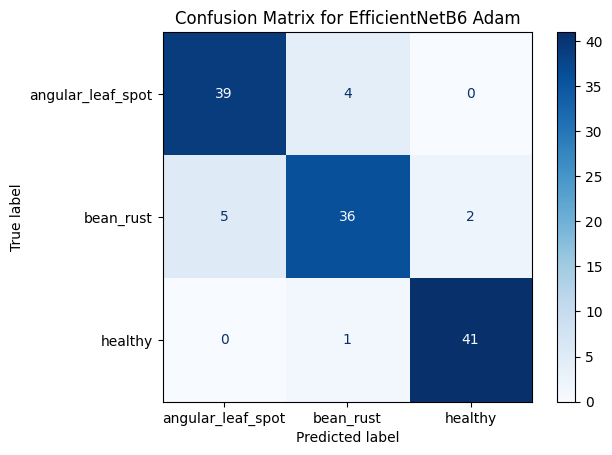

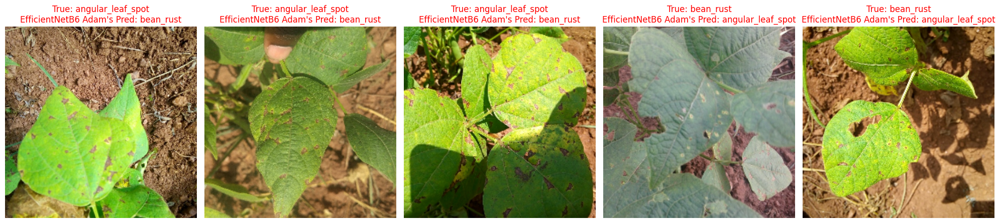

In [64]:
visualize_predictions(test_data, "checkpoints/best_model_eff_net_adam.h5", "EfficientNetB6 Adam", preprocess_function=None)

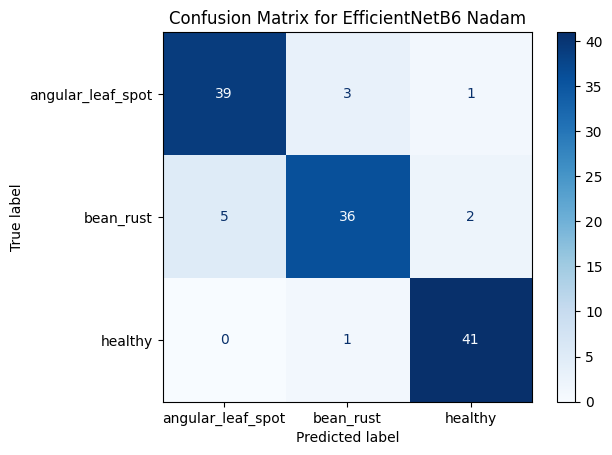

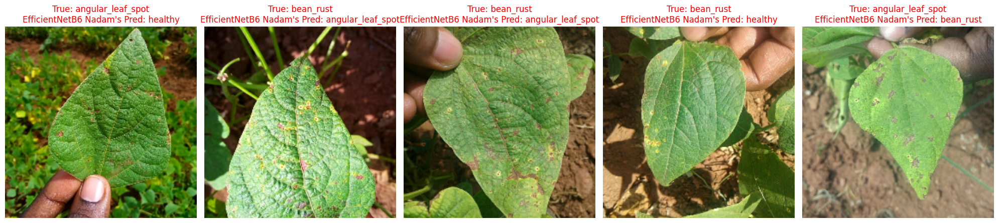

In [65]:
visualize_predictions(test_data, "checkpoints/best_model_eff_net_nadam.h5", "EfficientNetB6 Nadam", preprocess_function=None)

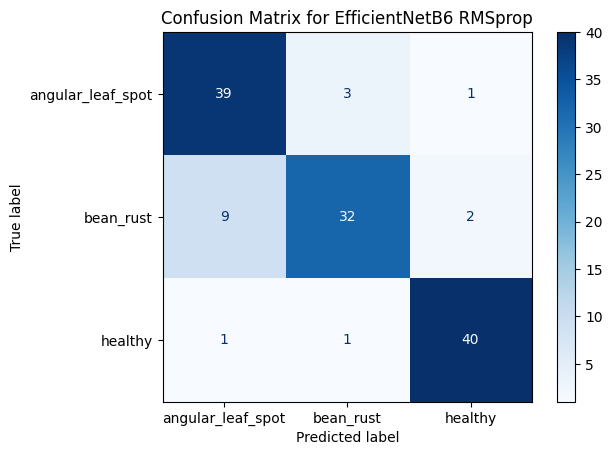

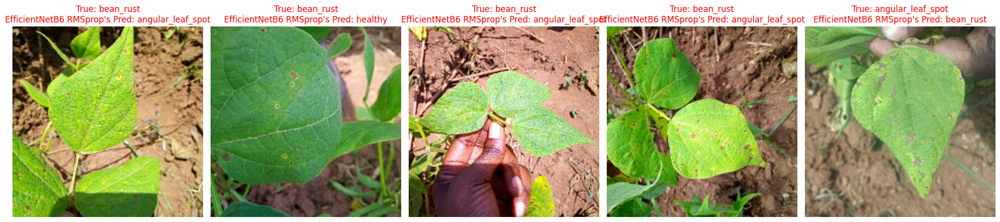

In [9]:
visualize_predictions(test_data, "checkpoints/best_model_eff_net_rmsprop.h5", "EfficientNetB6 RMSprop", preprocess_function=None)

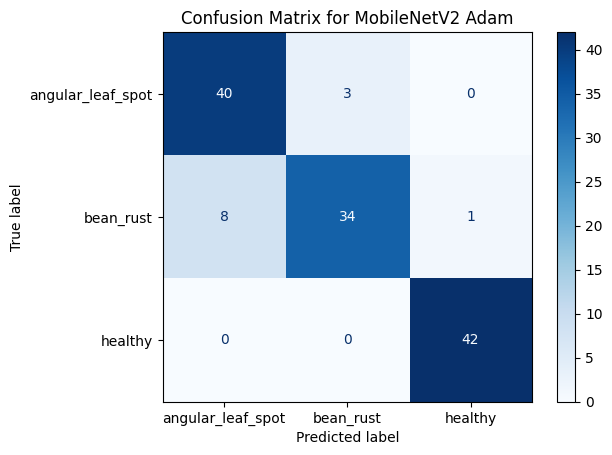

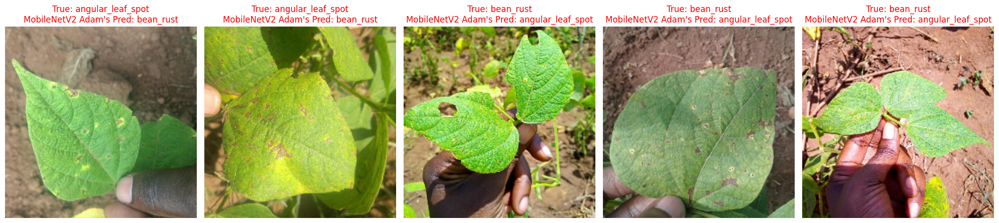

In [10]:
visualize_predictions(test_data, "checkpoints/best_model_mobile_net_adam.h5", "MobileNetV2 Adam", preprocess_function=mobile_net_preprocess)

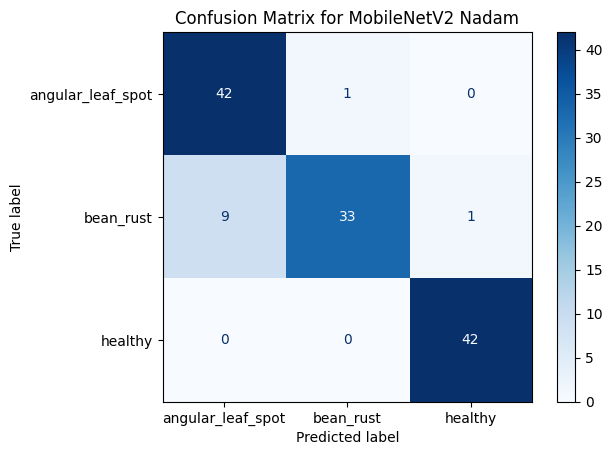

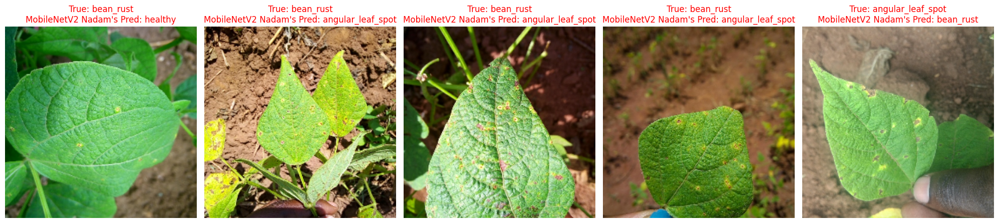

In [11]:
visualize_predictions(test_data, "checkpoints/best_model_mobile_net_nadam.h5", "MobileNetV2 Nadam", preprocess_function=mobile_net_preprocess)

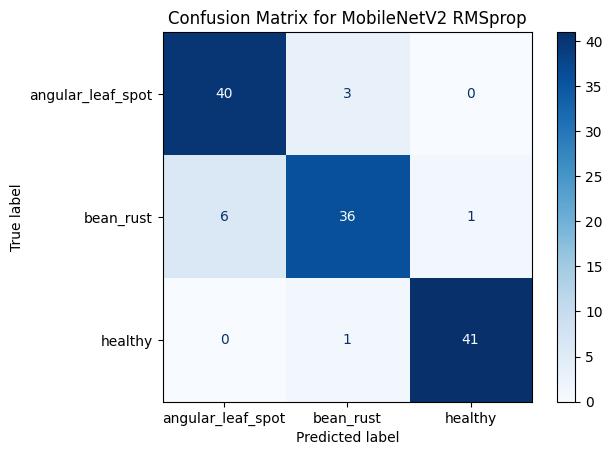

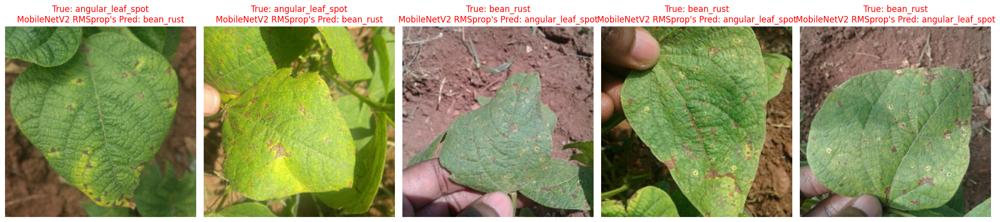

In [12]:
visualize_predictions(test_data, "checkpoints/best_model_mobile_net_rmsprop.h5", "MobileNetV2 RMSprop", preprocess_function=mobile_net_preprocess)

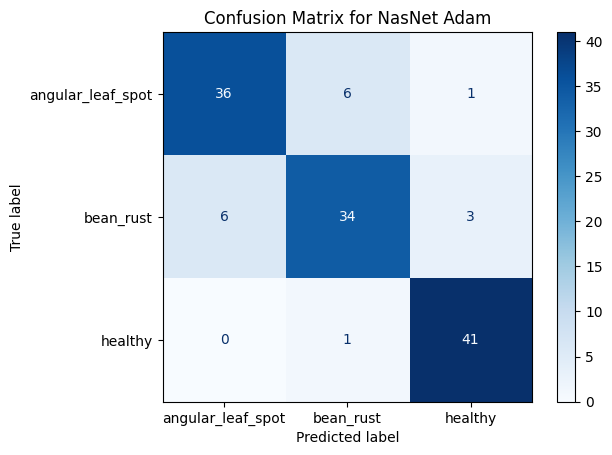

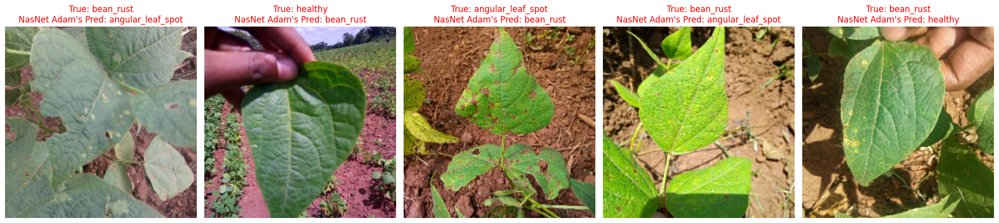

In [13]:
visualize_predictions(test_data, "checkpoints/best_model_nas_net_adam.h5", "NasNet Adam", preprocess_function=nasnet_preprocess)

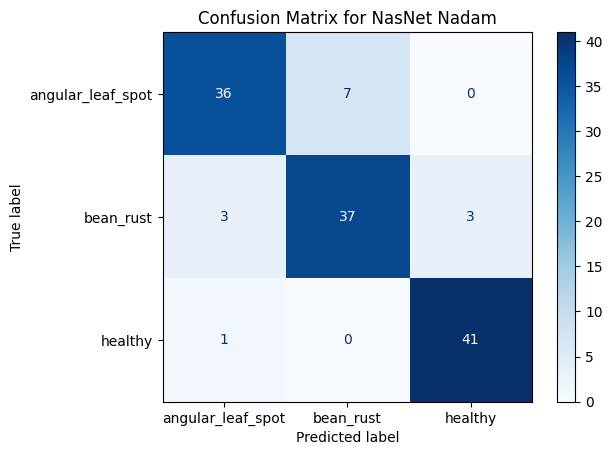

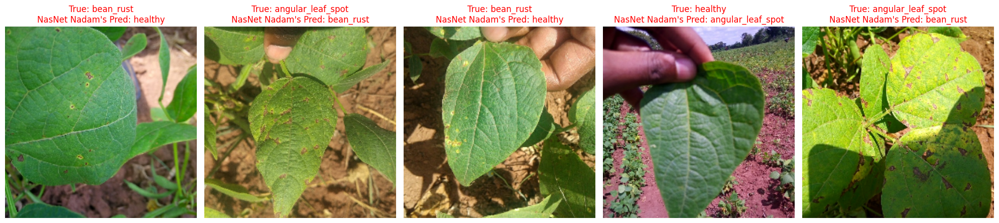

In [14]:
visualize_predictions(test_data, "checkpoints/best_model_nas_net_nadam.h5", "NasNet Nadam", preprocess_function=nasnet_preprocess)

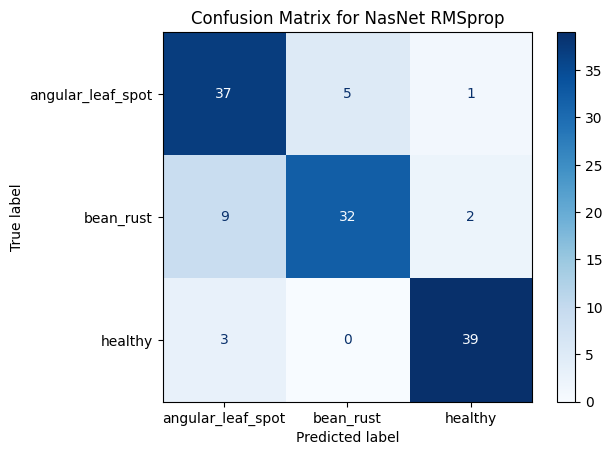

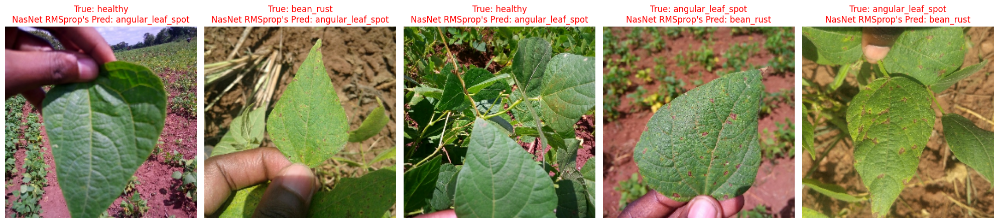

In [15]:
visualize_predictions(test_data, "checkpoints/best_model_nas_net_rmsprop.h5", "NasNet RMSprop", preprocess_function=nasnet_preprocess)